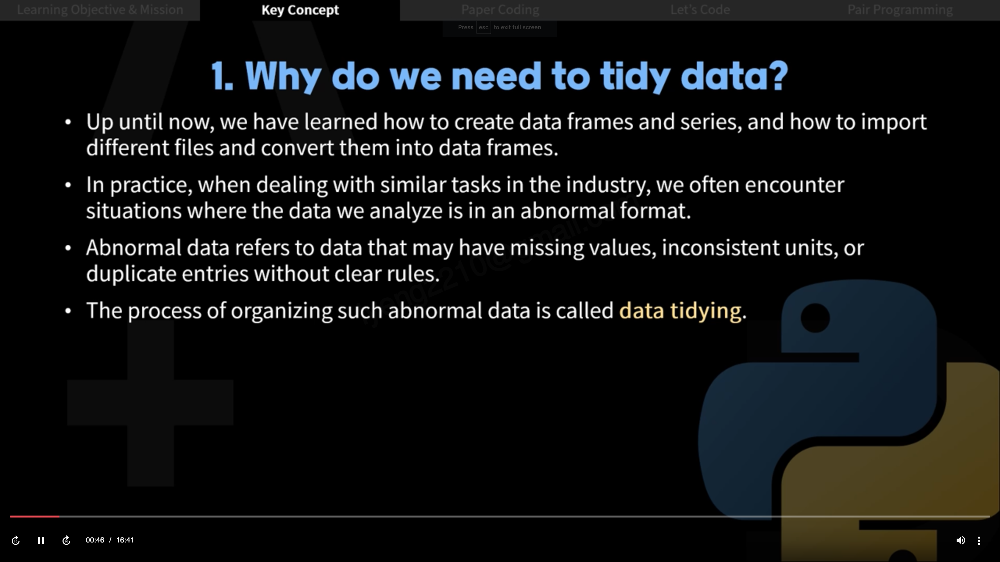

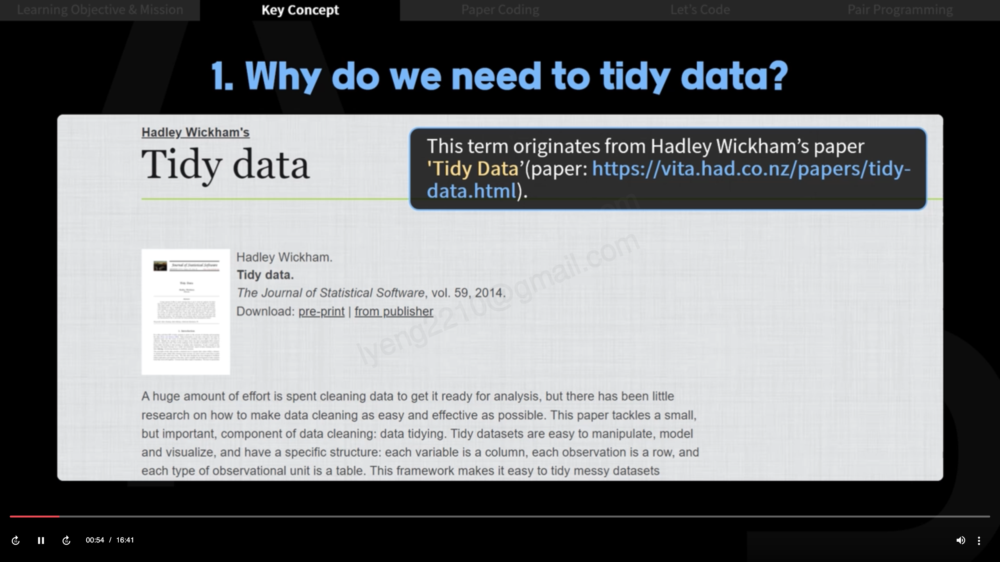

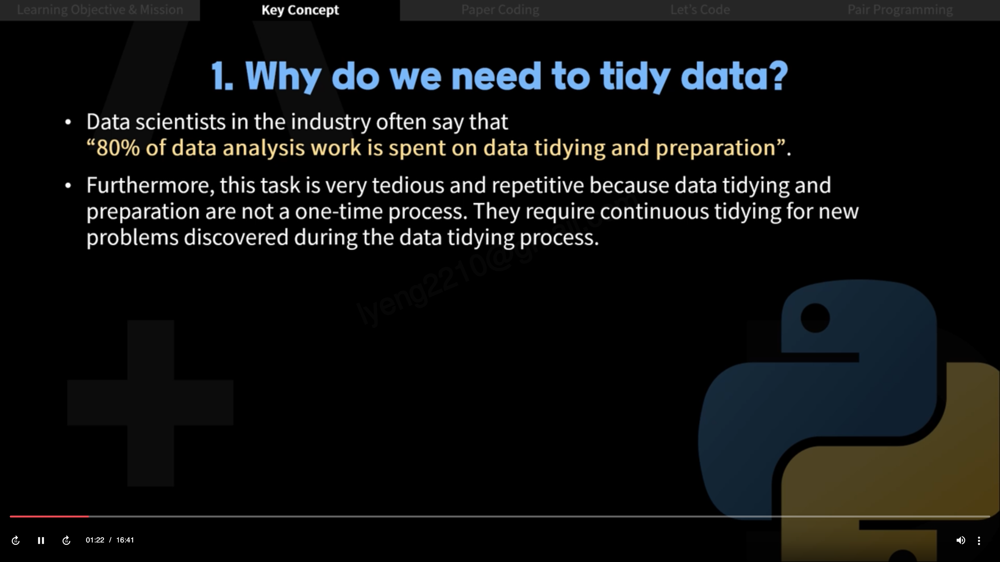

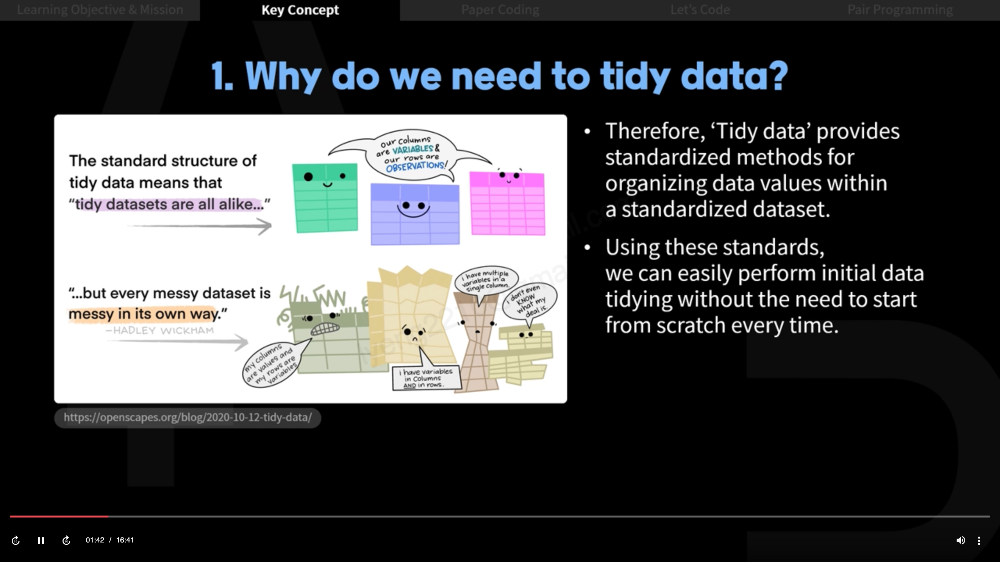

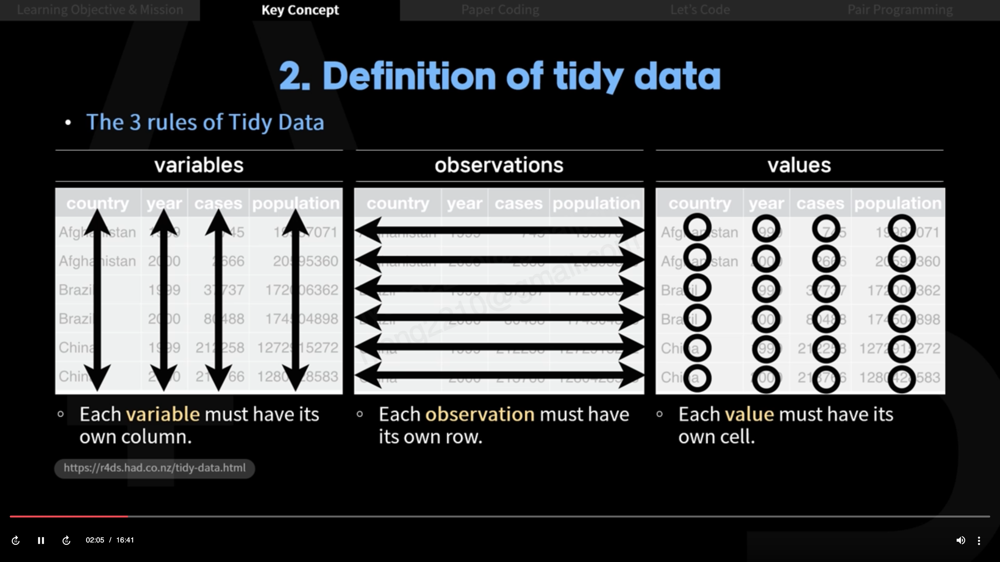

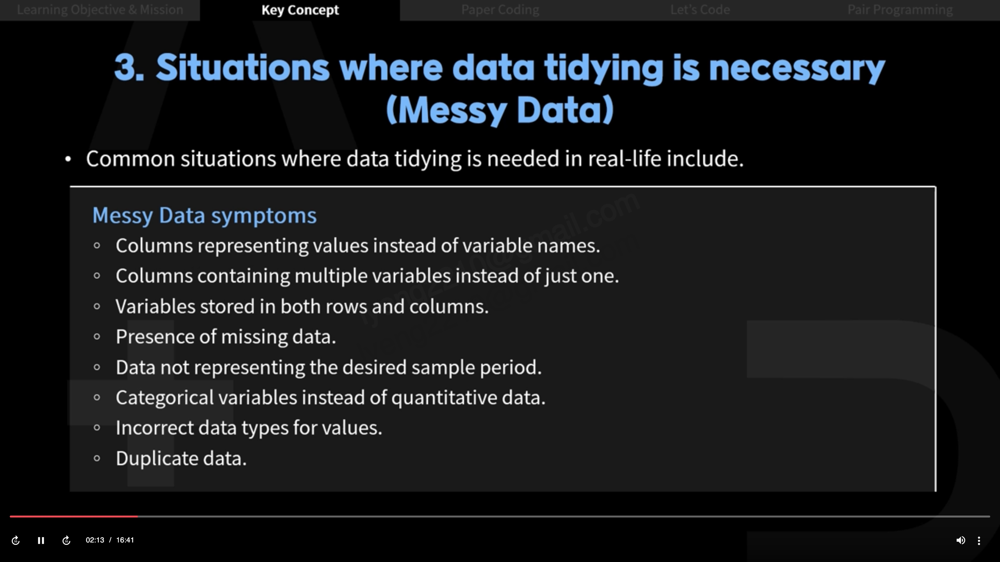

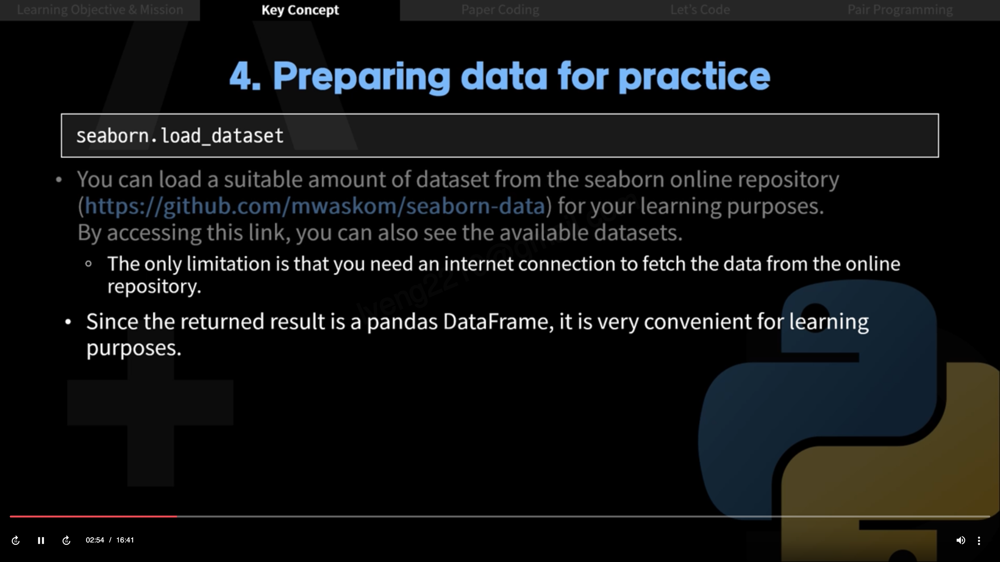

# 4 Preparing data for practice

In [6]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

df = sns.load_dataset('titanic',cache = True)

df.describe()

,survived,pclass,age,sibsp,parch,fare
count,891.000000,891.000000,714.000000,891.000000,891.000000,891.000000
mean,0.383838,2.308642,29.699118,0.523008,0.381594,32.204208
std,0.486592,0.836071,14.526497,1.102743,0.806057,49.693429
min,0.000000,1.000000,0.420000,0.000000,0.000000,0.000000
25%,0.000000,2.000000,20.125000,0.000000,0.000000,7.910400
50%,0.000000,3.000000,28.000000,0.000000,0.000000,14.454200
75%,1.000000,3.000000,38.000000,1.000000,0.000000,31.000000
max,1.000000,3.000000,80.000000,8.000000,6.000000,512.329200


In [7]:
df.shape

(891, 15)

# 5. Checking for missing data

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 891 entries, 0 to 890
Data columns (total 15 columns):
 #   Column       Non-Null Count  Dtype   
---  ------       --------------  -----   
 0   survived     891 non-null    int64   
 1   pclass       891 non-null    int64   
 2   sex          891 non-null    object  
 3   age          714 non-null    float64 
 4   sibsp        891 non-null    int64   
 5   parch        891 non-null    int64   
 6   fare         891 non-null    float64 
 7   embarked     889 non-null    object  
 8   class        891 non-null    category
 9   who          891 non-null    object  
 10  adult_male   891 non-null    bool    
 11  deck         203 non-null    category
 12  embark_town  889 non-null    object  
 13  alive        891 non-null    object  
 14  alone        891 non-null    bool    
dtypes: bool(2), category(2), float64(2), int64(4), object(5)
memory usage: 80.7+ KB


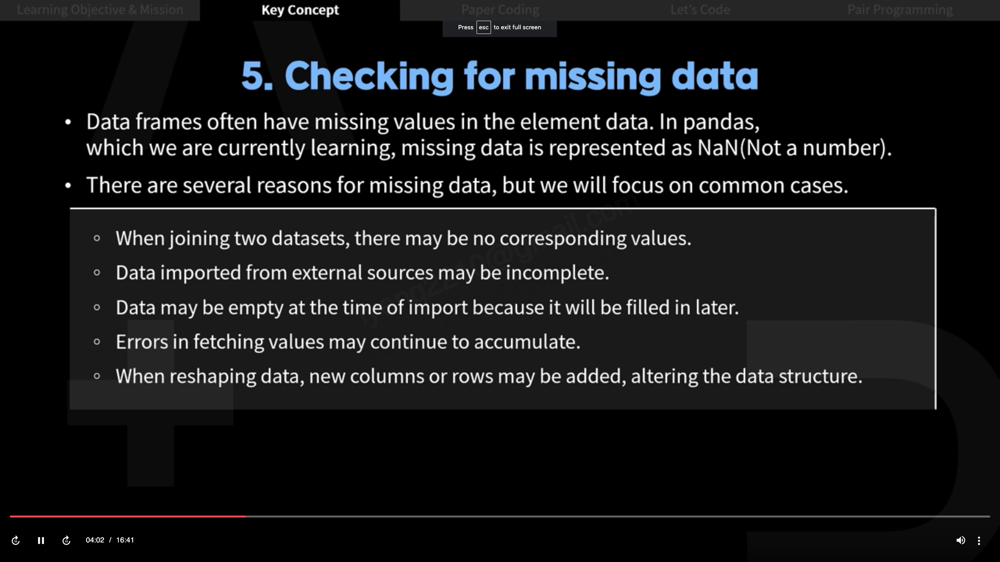

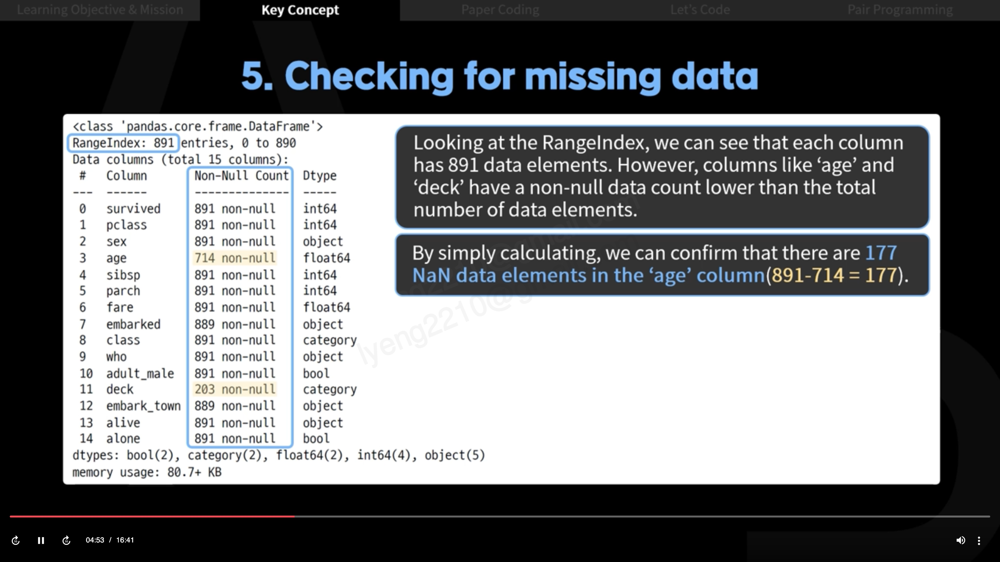

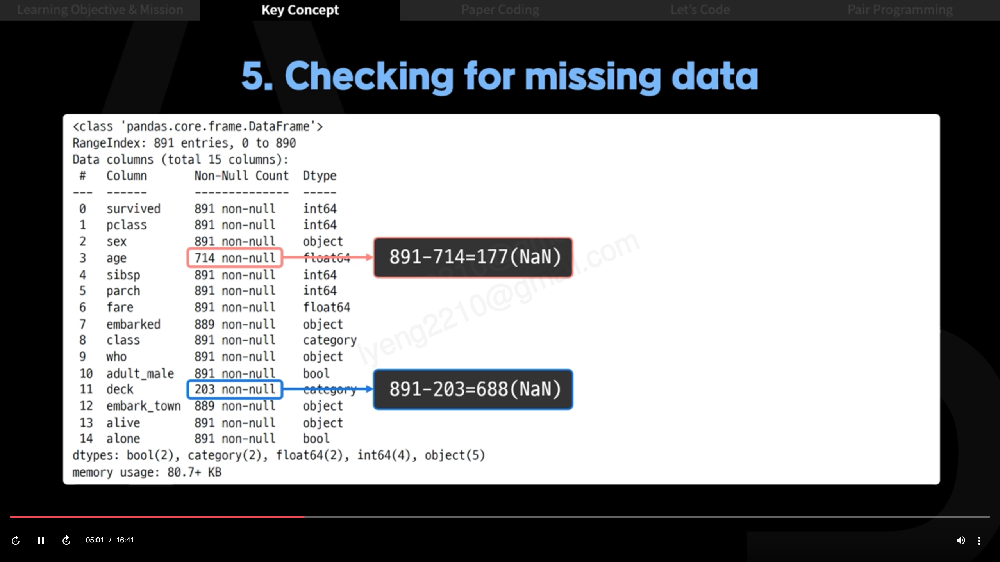

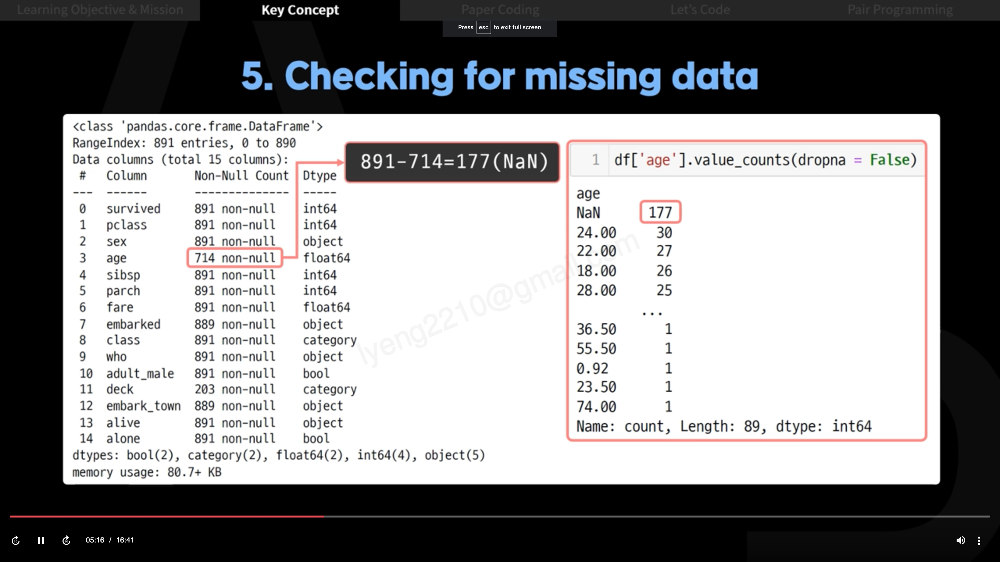

In [8]:
df['age'].value_counts(dropna = False)

NaN      177
24.00     30
22.00     27
18.00     26
28.00     25
        ... 
36.50      1
55.50      1
0.92       1
23.50      1
74.00      1
Name: age, Length: 89, dtype: int64

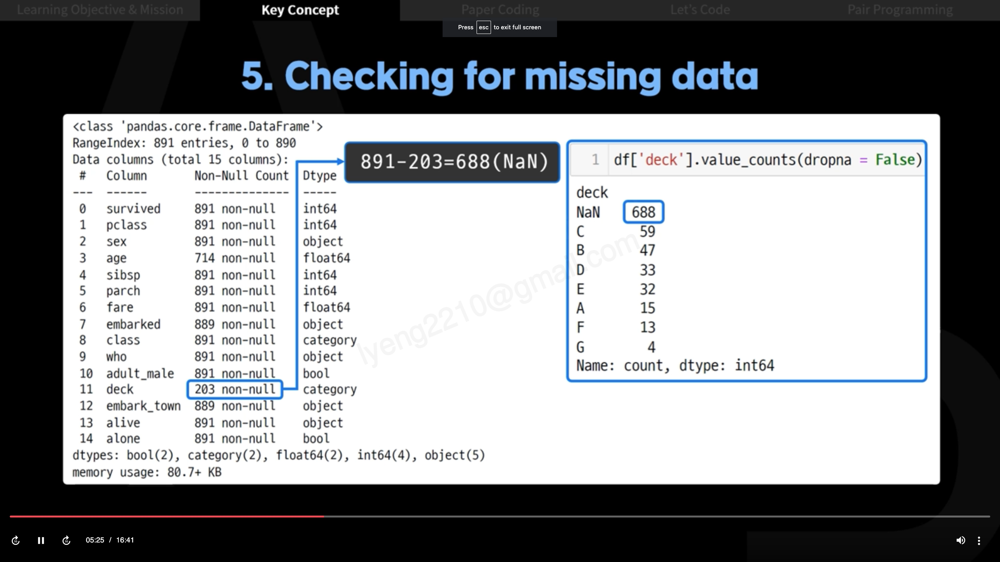

df['deck'].value_counts(dropna = False)

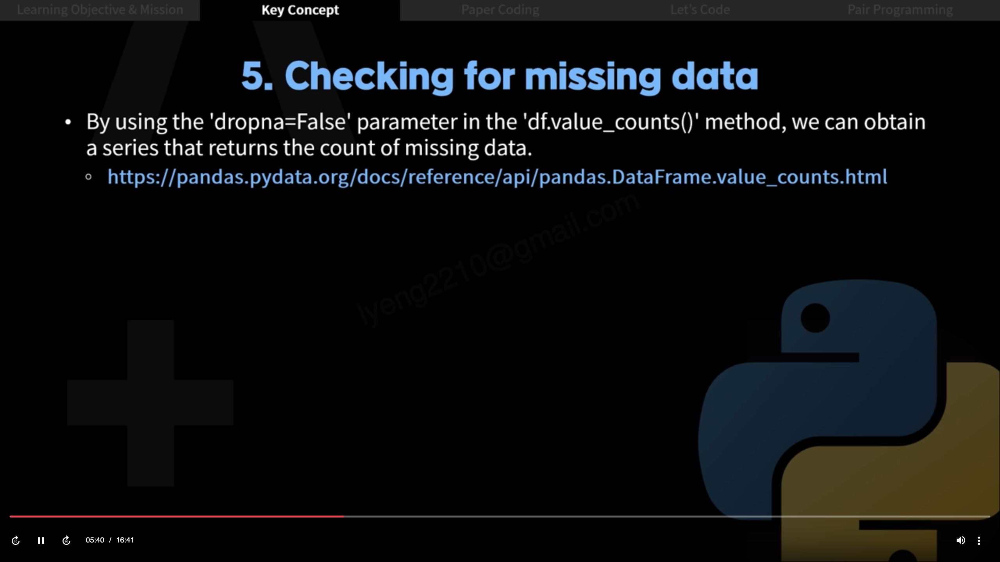

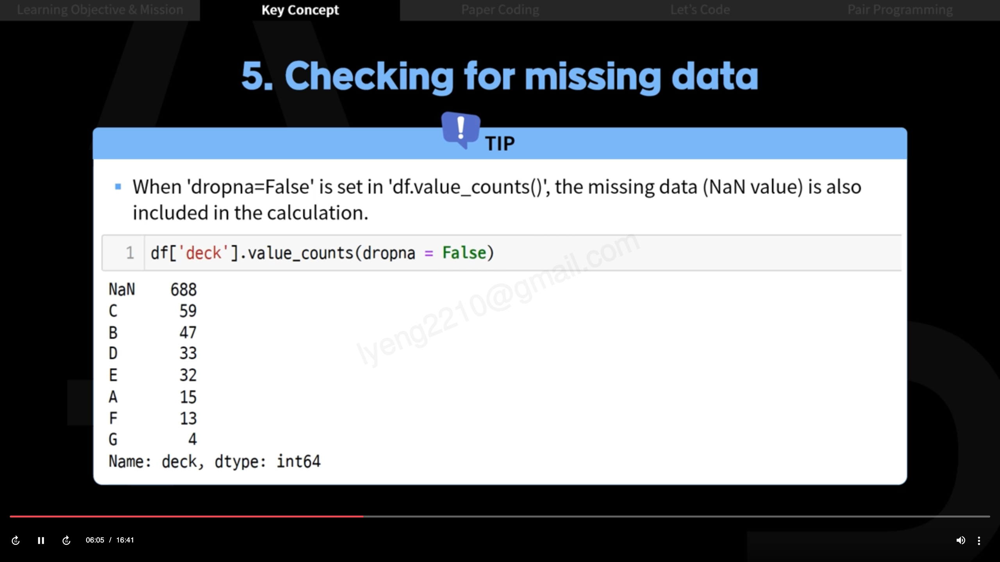

In [9]:
df['deck'].value_counts(dropna = False)

NaN    688
C       59
B       47
D       33
E       32
A       15
F       13
G        4
Name: deck, dtype: int64

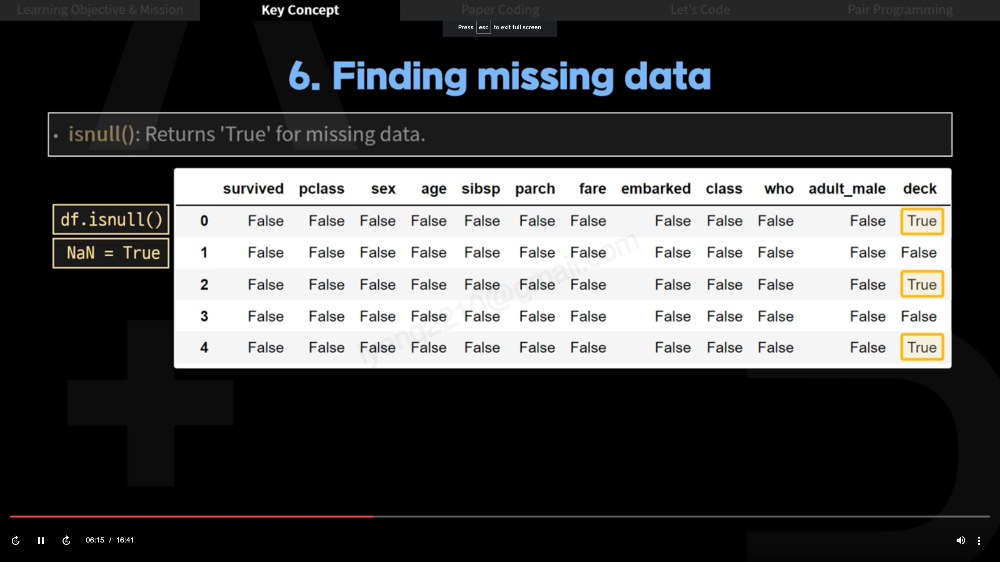

In [10]:
df.isnull()

,survived,pclass,sex,age,sibsp,parch,fare,embarked,class,who,adult_male,deck,embark_town,alive,alone
0,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False
1,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False
3,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
886,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False
887,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
888,False,False,False,True,False,False,False,False,False,False,False,True,False,False,False
889,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False


In [11]:
df.notnull()

,survived,pclass,sex,age,sibsp,parch,fare,embarked,class,who,adult_male,deck,embark_town,alive,alone
0,True,True,True,True,True,True,True,True,True,True,True,False,True,True,True
1,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
2,True,True,True,True,True,True,True,True,True,True,True,False,True,True,True
3,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
4,True,True,True,True,True,True,True,True,True,True,True,False,True,True,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
886,True,True,True,True,True,True,True,True,True,True,True,False,True,True,True
887,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
888,True,True,True,False,True,True,True,True,True,True,True,False,True,True,True
889,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True


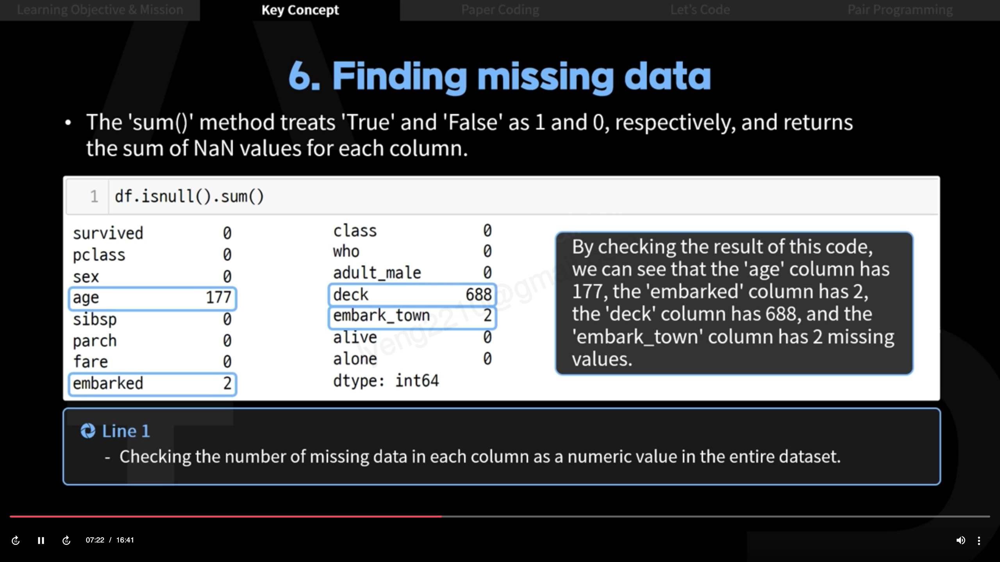

In [12]:
df.isnull().sum()

survived         0
pclass           0
sex              0
age            177
sibsp            0
parch            0
fare             0
embarked         2
class            0
who              0
adult_male       0
deck           688
embark_town      2
alive            0
alone            0
dtype: int64

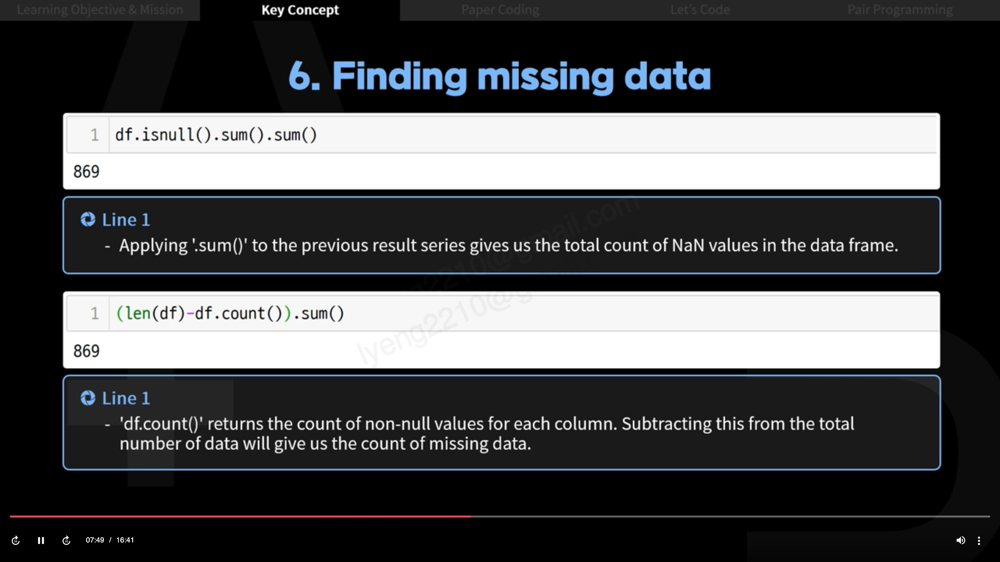

In [13]:
df.isnull().sum().sum()

869

In [15]:
(len(df)-df.count()).sum()

869

# 7. Deleting missing data

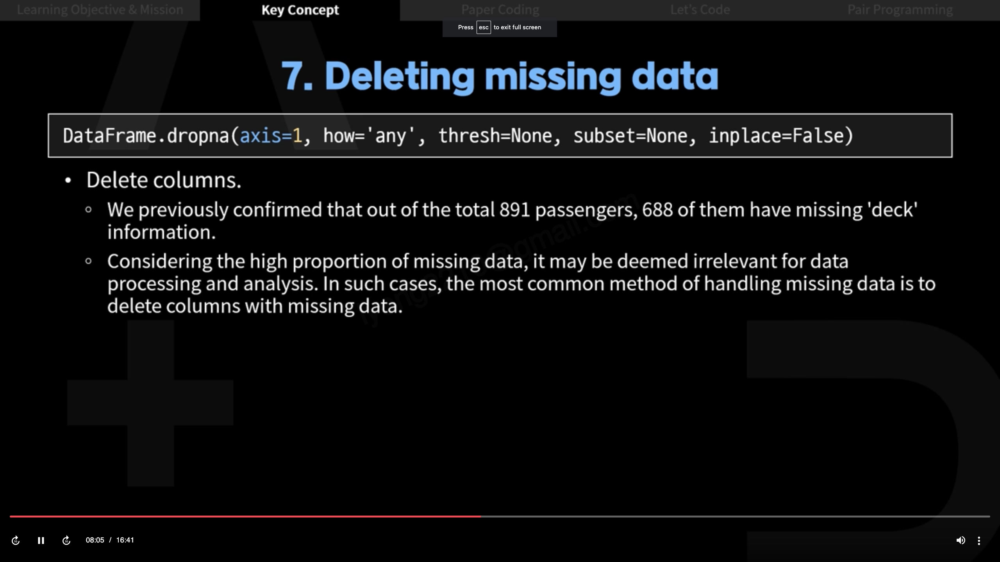

In [16]:
new_df = df.dropna(axis = 1, thresh = 500)
# 'thresh=500' means to delete all columns that have 500 or more NaN values.

new_df.head()
# since the 'deck' column has 688 NaN values, which is more than 500,
# we can see that 'deck' column is  completely deleted.

,survived,pclass,sex,age,sibsp,parch,fare,embarked,class,who,adult_male,embark_town,alive,alone
0,0,3,male,22.0,1,0,7.2500,S,Third,man,True,Southampton,no,False
1,1,1,female,38.0,1,0,71.2833,C,First,woman,False,Cherbourg,yes,False
2,1,3,female,26.0,0,0,7.9250,S,Third,woman,False,Southampton,yes,True
3,1,1,female,35.0,1,0,53.1000,S,First,woman,False,Southampton,yes,False
4,0,3,male,35.0,0,0,8.0500,S,Third,man,True,Southampton,no,True


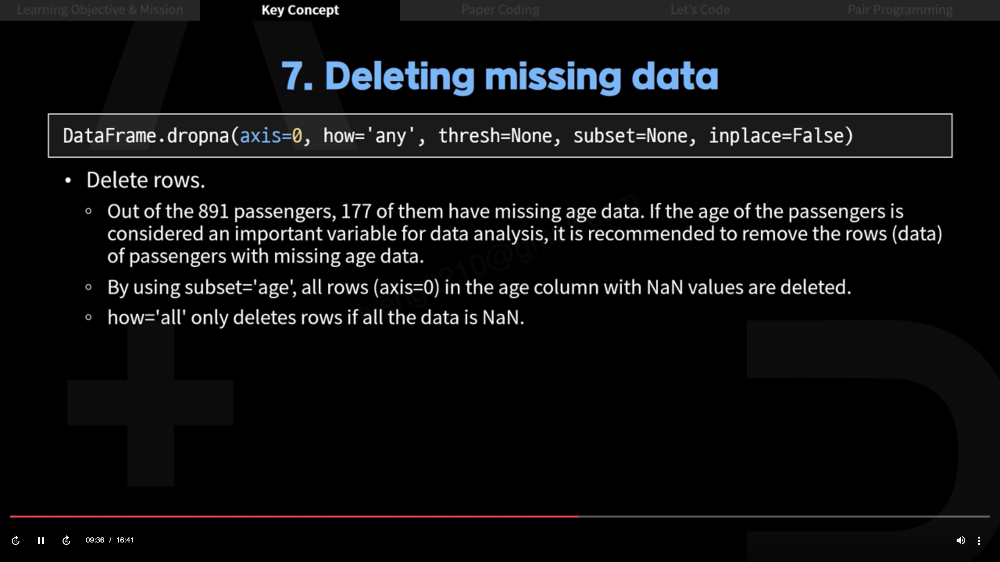

In [17]:
age_df = df.dropna(axis = 0, how = 'any', subset = ['age'])
# we deleted the 177 rows without age data

len(age_df)

714

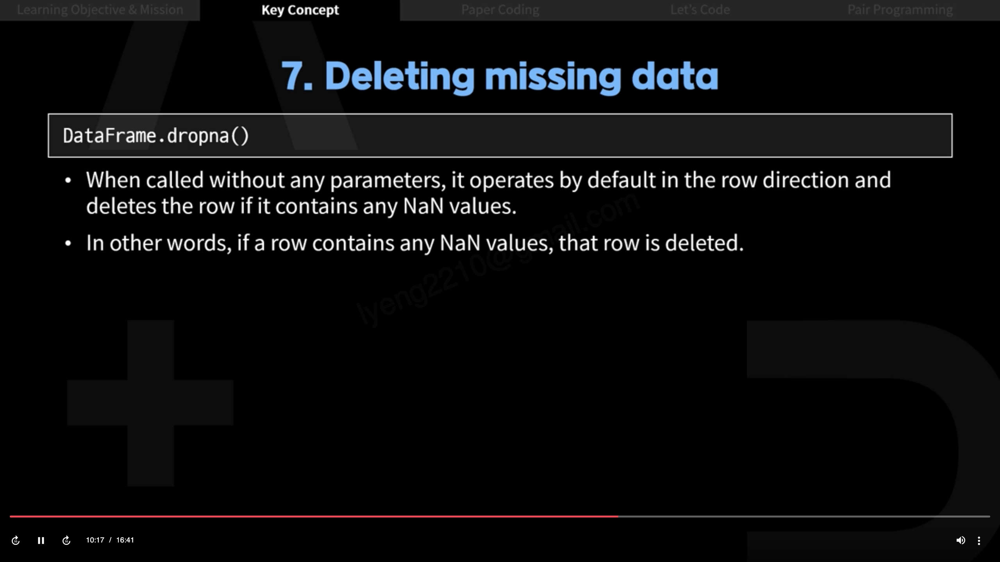

In [18]:
no = df.dropna()
no.isnull().sum()

survived       0
pclass         0
sex            0
age            0
sibsp          0
parch          0
fare           0
embarked       0
class          0
who            0
adult_male     0
deck           0
embark_town    0
alive          0
alone          0
dtype: int64

In [19]:
len(no)

182

In [20]:
no = df.dropna(axis = 0, how = 'any')
len(no)

182

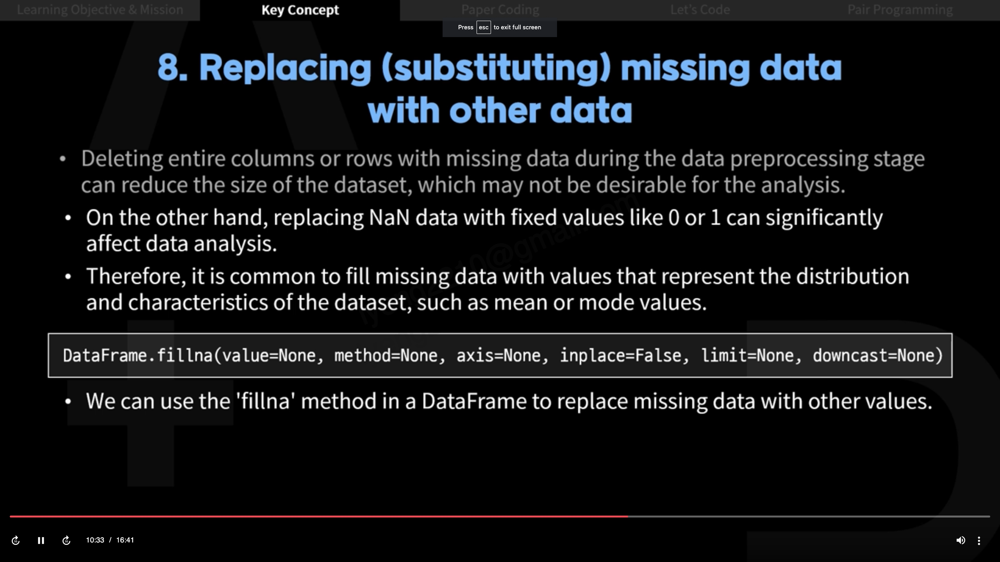

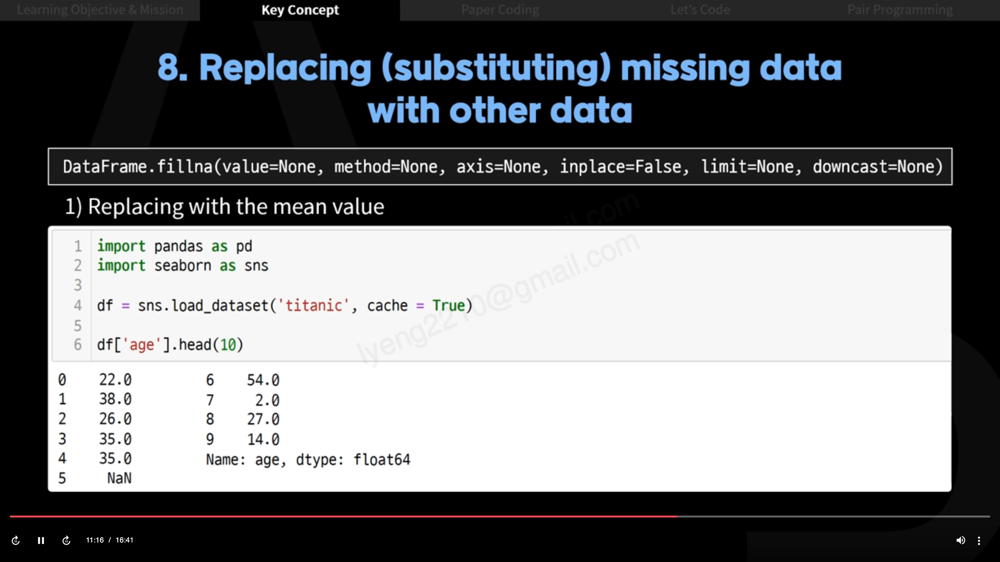

In [21]:
import pandas as pd
import  seaborn as sns

df = sns.load_dataset('titanic', cache = True) # Load the titanic dataset

df['age'].head(10)
# when checking the data in the 'age' column, NaN values are found.

0    22.0
1    38.0
2    26.0
3    35.0
4    35.0
5     NaN
6    54.0
7     2.0
8    27.0
9    14.0
Name: age, dtype: float64

In [22]:
avg_age = df['age'].mean(axis = 0)
avg_age

# calculate the mean value of the age data and store it in 'avg_age'.
# It represents the average value of the 'age' column data.

29.69911764705882

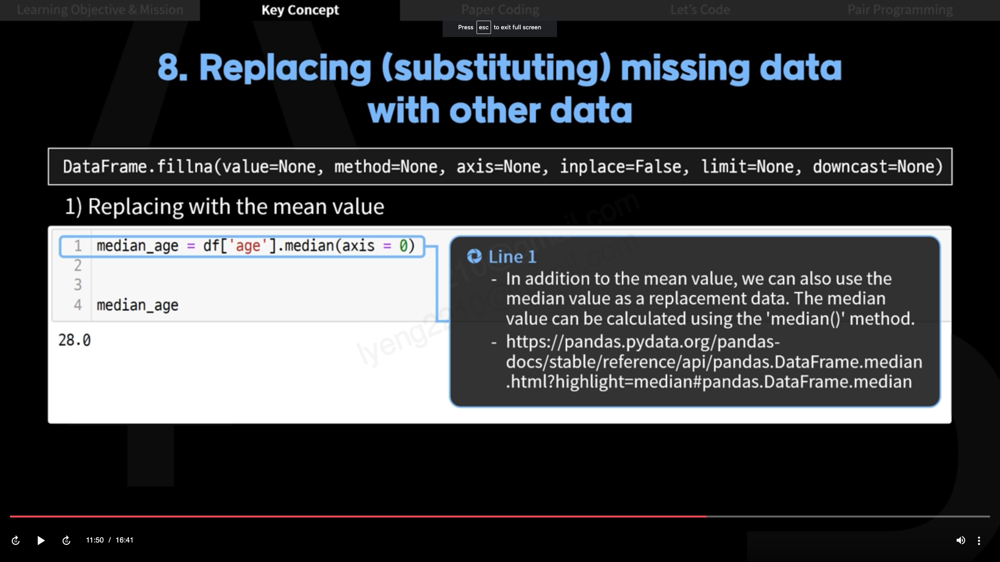

In [23]:
median_age = df['age'].median(axis = 0)

median_age

28.0

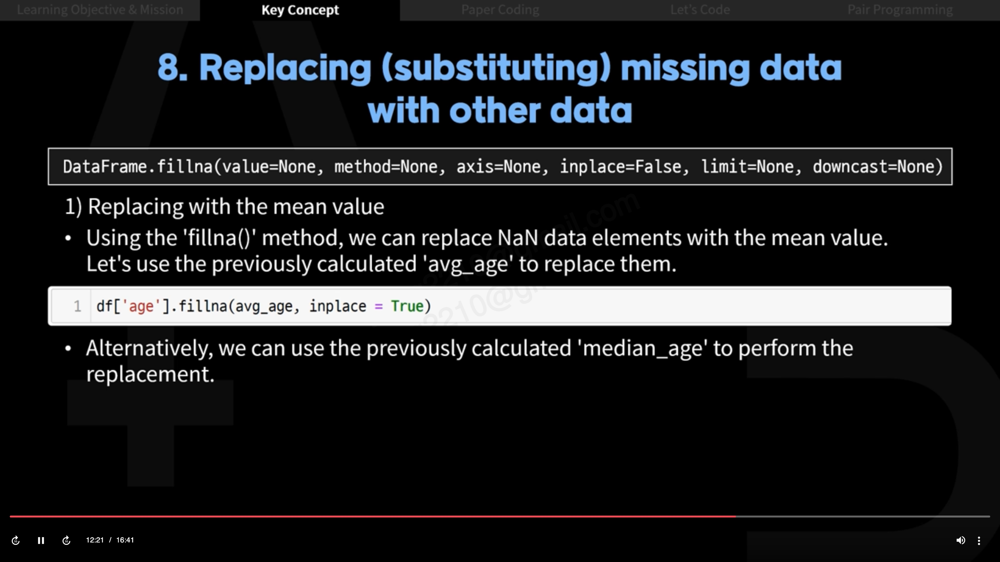

In [24]:
df['age'].fillna(avg_age, inplace = True)

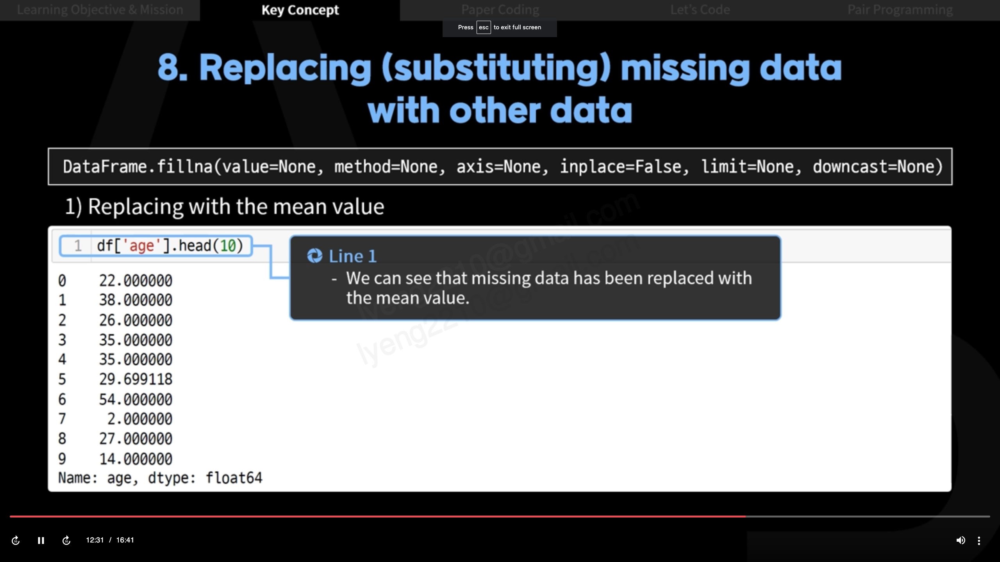

In [25]:
df['age'].head(10)

0    22.000000
1    38.000000
2    26.000000
3    35.000000
4    35.000000
5    29.699118
6    54.000000
7     2.000000
8    27.000000
9    14.000000
Name: age, dtype: float64

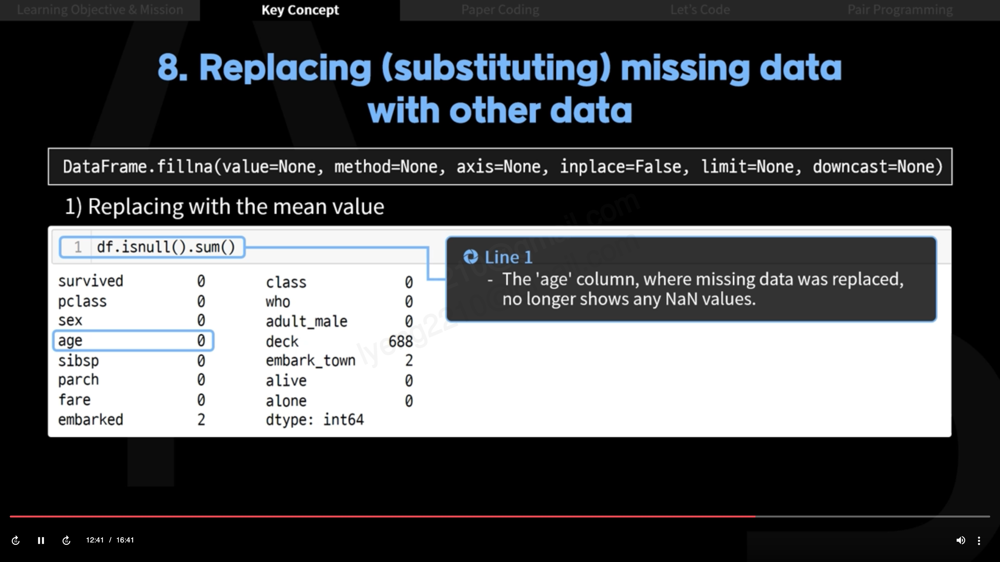

In [26]:
df.isnull().sum()

survived         0
pclass           0
sex              0
age              0
sibsp            0
parch            0
fare             0
embarked         2
class            0
who              0
adult_male       0
deck           688
embark_town      2
alive            0
alone            0
dtype: int64

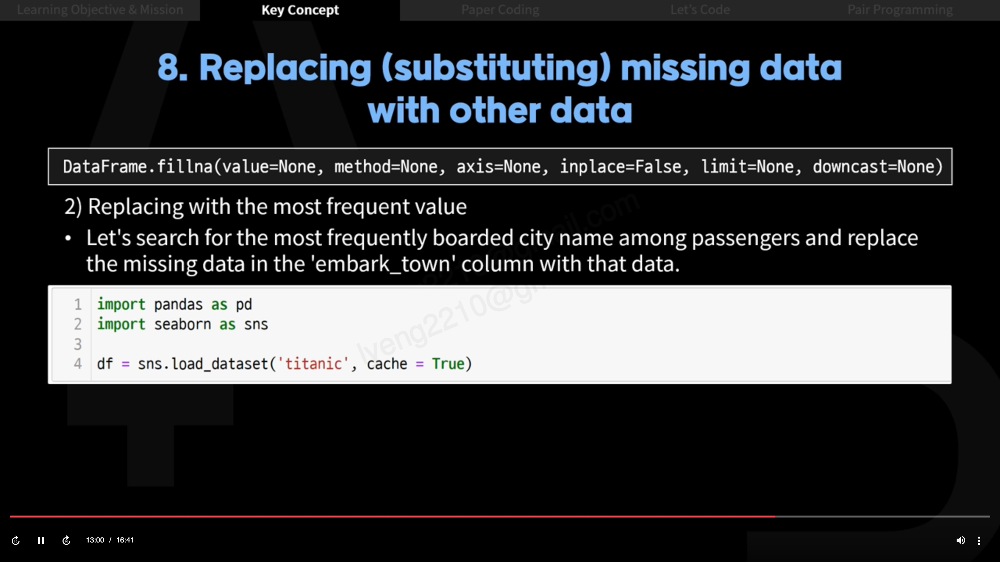

In [27]:
import pandas as pd
import seaborn as sns

df = sns.load_dataset('titanic', cache = True)

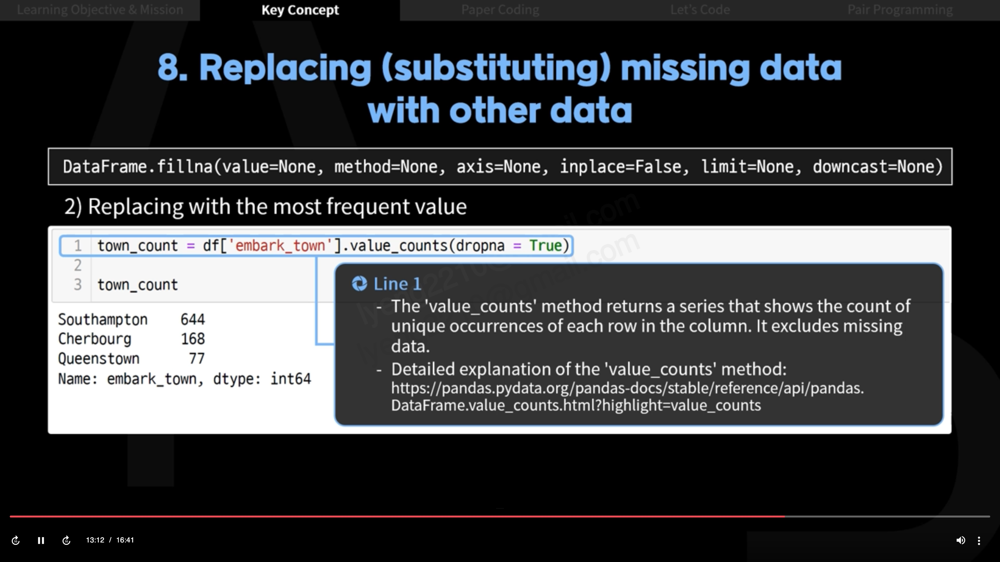

In [28]:
town_count = df['embark_town'].value_counts(dropna = True)

town_count

Southampton    644
Cherbourg      168
Queenstown      77
Name: embark_town, dtype: int64

In [29]:
type(town_count)

pandas.core.series.Series

In [31]:
most = town_count.idxmax()
most

# idxmax() returns the index where the maximum value first occurs in the requested axis

'Southampton'

In [32]:
df['embark_town'].fillna(most, inplace = True)
# using the 'fillna()' method, we replace NaN data elements with the most
# frequent city name stored in the 'most' variable.

df.isnull().sum()
# the previously missing data in the 'embark_town' column has been replaced
# with 'Southampton', and now there are no missing data in that column.

survived         0
pclass           0
sex              0
age            177
sibsp            0
parch            0
fare             0
embarked         2
class            0
who              0
adult_male       0
deck           688
embark_town      0
alive            0
alone            0
dtype: int64

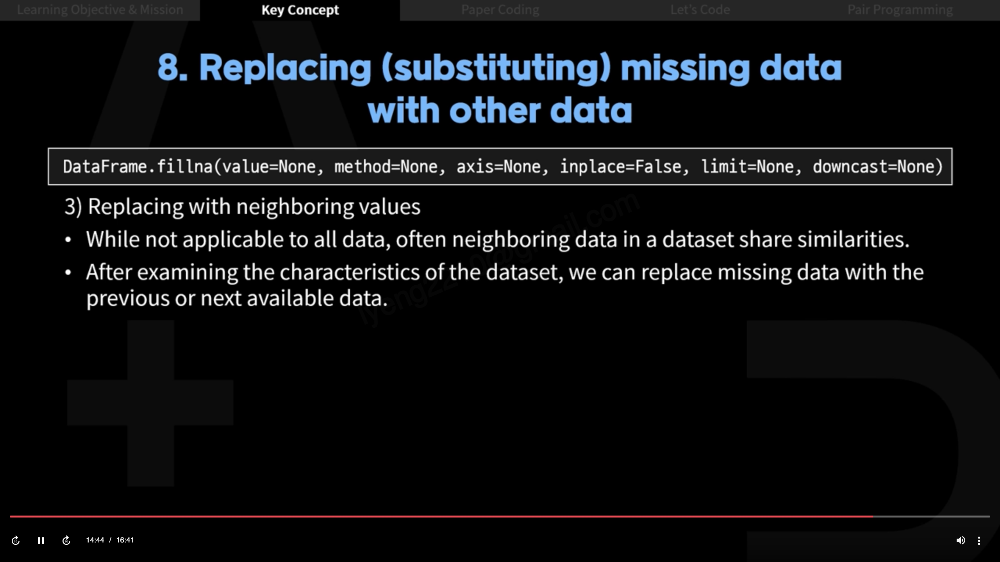

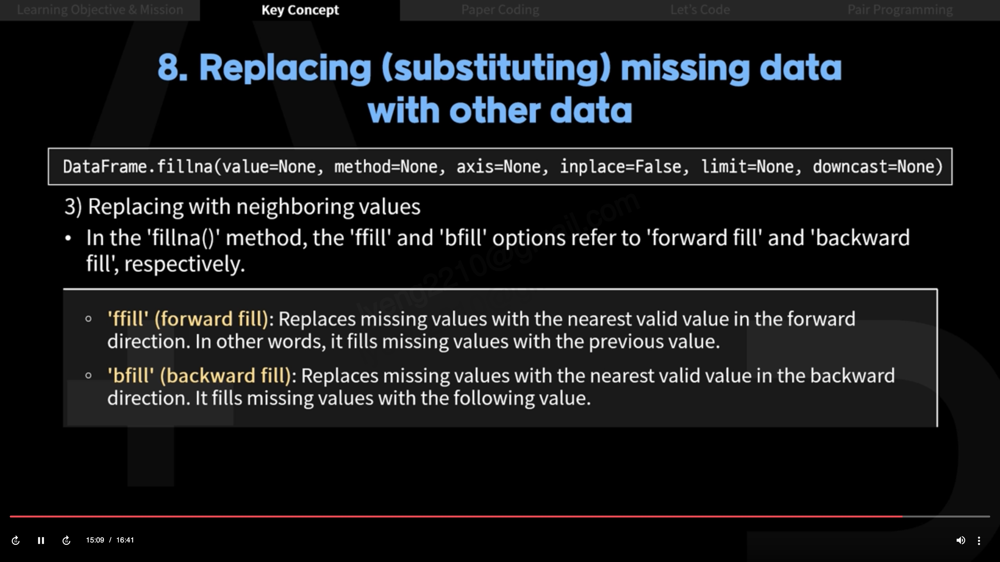

In [34]:
import pandas as pd
import seaborn as sns

df = sns.load_dataset('titanic', cache = True)
null_indexes = df[df['embark_town'].isna()].index
# to return the index of rows with missing data in a specific column,
# we can select the column, use the 'isna()' method to identify the locations
# of missing dat a, and index it to obtain the corresponding indices.


null_indexes
# the 'embark_town' column, we can see that there are missing data at indices 61 and 829.

Int64Index([61, 829], dtype='int64')

In [35]:
df[60 : 63]
# there are missing value in 'embark_town' column

,survived,pclass,sex,age,sibsp,parch,fare,embarked,class,who,adult_male,deck,embark_town,alive,alone
60,0,3,male,22.0,0,0,7.2292,C,Third,man,True,NaN,Cherbourg,no,True
61,1,1,female,38.0,0,0,80.0000,NaN,First,woman,False,B,NaN,yes,True
62,0,1,male,45.0,1,0,83.4750,S,First,man,True,C,Southampton,no,False


In [45]:
df['embark_town'].fillna(method = 'ffill', inplace = True)
df[60 : 63]

,survived,pclass,sex,age,sibsp,parch,fare,embarked,class,who,adult_male,deck,embark_town,alive,alone
60,0,3,male,22.0,0,0,7.2292,C,Third,man,True,NaN,Cherbourg,no,True
61,1,1,female,38.0,0,0,80.0000,NaN,First,woman,False,B,Southampton,yes,True
62,0,1,male,45.0,1,0,83.4750,S,First,man,True,C,Southampton,no,False


In [44]:
df = sns.load_dataset('titanic', cache = True)
df['embark_town'].fillna(method = 'bfill', inplace = True)
df[60 : 63]

,survived,pclass,sex,age,sibsp,parch,fare,embarked,class,who,adult_male,deck,embark_town,alive,alone
60,0,3,male,22.0,0,0,7.2292,C,Third,man,True,NaN,Cherbourg,no,True
61,1,1,female,38.0,0,0,80.0000,NaN,First,woman,False,B,Southampton,yes,True
62,0,1,male,45.0,1,0,83.4750,S,First,man,True,C,Southampton,no,False


# 25.3 Let's code

  school sex  age address famsize Pstatus  Medu  Fedu     Mjob      Fjob  ...  \
0     GP   F   18       U     GT3       A     4     4  at_home   teacher  ...   
1     GP   F   17       U     GT3       T     1     1  at_home     other  ...   
2     GP   F   15       U     LE3       T     1     1  at_home     other  ...   
3     GP   F   15       U     GT3       T     4     2   health  services  ...   
4     GP   F   16       U     GT3       T     3     3    other     other  ...   

  famrel freetime  goout  Dalc  Walc health absences  G1  G2  G3  
0      4        3      4     1     1      3        6   5   6   6  
1      5        3      3     1     1      3        4   5   5   6  
2      4        3      2     2     3      3       10   7   8  10  
3      3        2      2     1     1      5        2  15  14  15  
4      4        3      2     1     2      5        4   6  10  10  

[5 rows x 33 columns]

 <Basic information for data>
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 395 ent

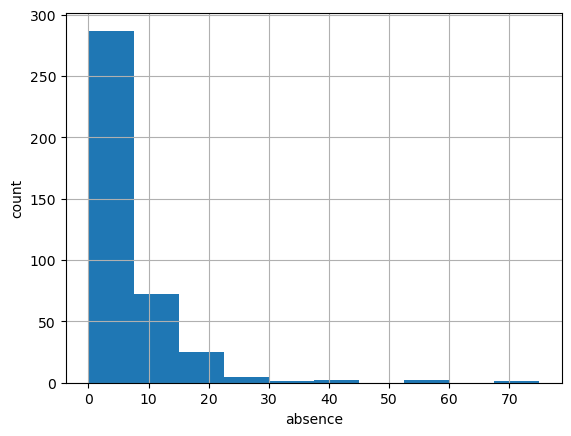

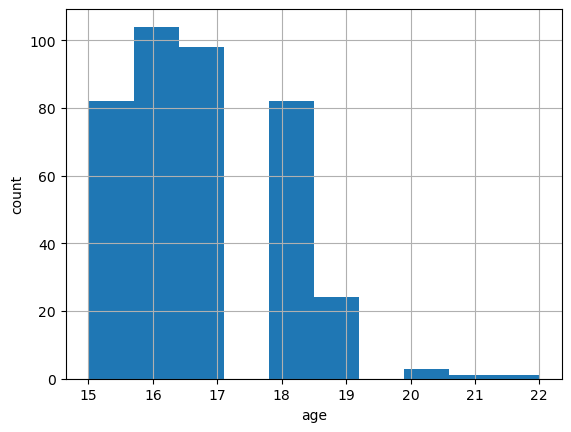


 <Technical Statistics Summary Information>
              age        Medu        Fedu  traveltime   studytime    failures  \
count  395.000000  395.000000  395.000000  395.000000  395.000000  395.000000   
mean    16.696203    2.749367    2.521519    1.448101    2.035443    0.334177   
std      1.276043    1.094735    1.088201    0.697505    0.839240    0.743651   
min     15.000000    0.000000    0.000000    1.000000    1.000000    0.000000   
25%     16.000000    2.000000    2.000000    1.000000    1.000000    0.000000   
50%     17.000000    3.000000    2.000000    1.000000    2.000000    0.000000   
75%     18.000000    4.000000    3.000000    2.000000    2.000000    0.000000   
max     22.000000    4.000000    4.000000    4.000000    4.000000    3.000000   

           famrel    freetime       goout        Dalc        Walc      health  \
count  395.000000  395.000000  395.000000  395.000000  395.000000  395.000000   
mean     3.944304    3.235443    3.108861    1.481013    2.2911

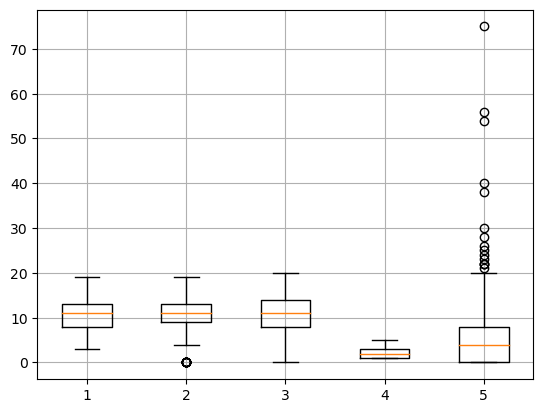


 <Coefficient of variation>
age           0.076427
Medu          0.398177
Fedu          0.431565
traveltime    0.481668
studytime     0.412313
failures      2.225319
famrel        0.227330
freetime      0.308725
goout         0.358098
Dalc          0.601441
Walc          0.562121
health        0.391147
absences      1.401873
G1            0.304266
G2            0.351086
G3            0.439881
dtype: float64

 <Covariance>
                 age      Medu      Fedu  traveltime  studytime  failures  \
age         1.628285 -0.228619 -0.226949    0.062873  -0.004434  0.231221   
Medu       -0.228619  1.198445  0.742717   -0.131061   0.059667 -0.192681   
Fedu       -0.226949  0.742717  1.184180   -0.120073  -0.008379 -0.202641   
traveltime  0.062873 -0.131061 -0.120073    0.486513  -0.059070  0.047844   
studytime  -0.004434  0.059667 -0.008379   -0.059070   0.704324 -0.108321   
failures    0.231221 -0.192681 -0.202641    0.047844  -0.108321  0.553017   
famrel      0.061717 -0.003842 -0.

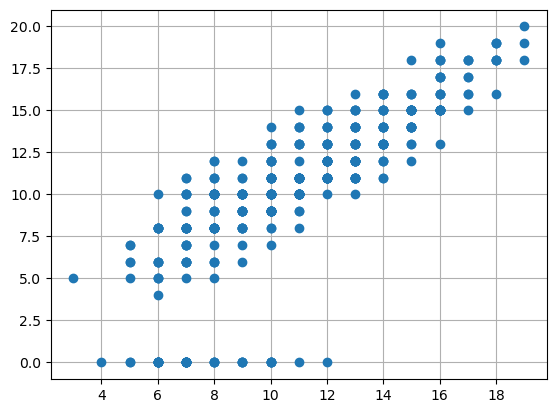

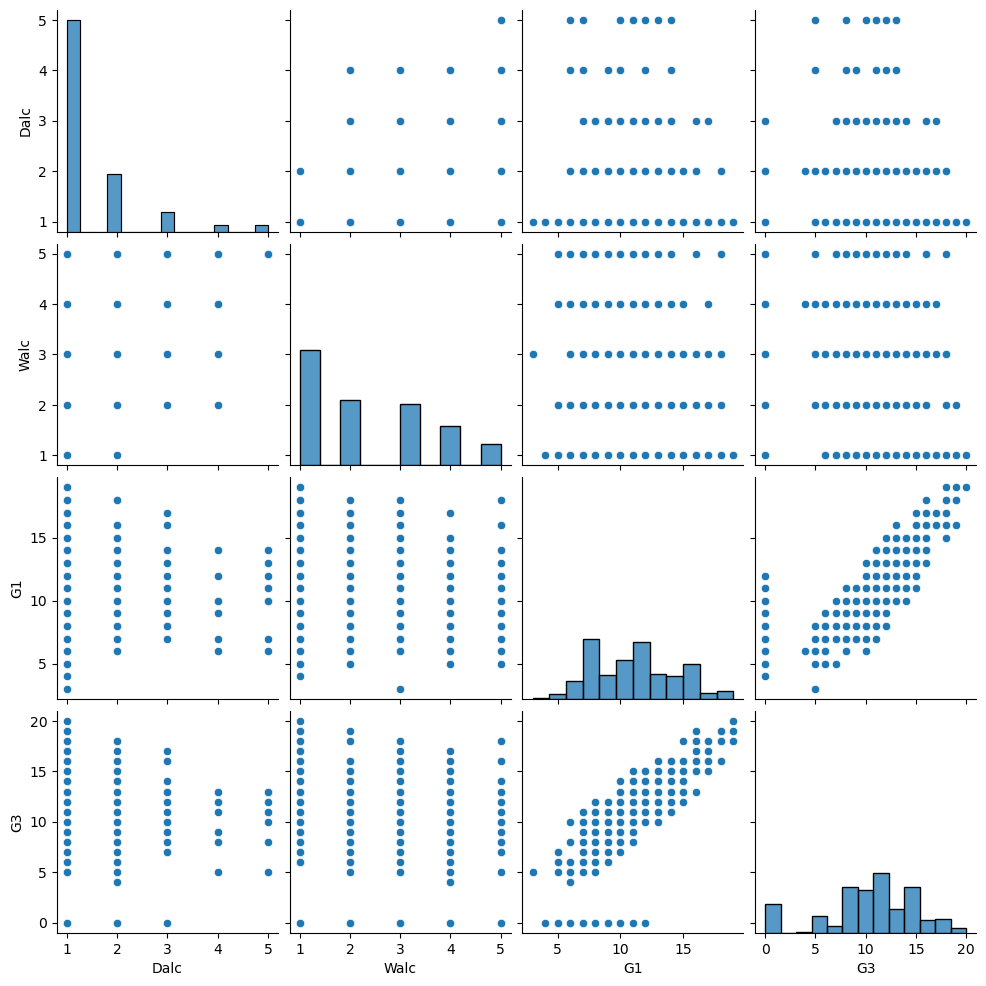

In [48]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

student_data = pd.read_csv("./data/student-mat.csv", sep = ';')
print(student_data.head())

print('\n <Basic information for data>')
print(student_data.info())

print('\n <Missing data>')
print(student_data.isnull().sum())
print('\n => Total of Missing data:', student_data.isnull().sum().sum())

plt.hist(student_data['absences'])
plt.xlabel('absence')
plt.ylabel('count')
plt.grid(True)
plt.show()

plt.hist(student_data['age'])
plt.xlabel('age')
plt.ylabel('count')
plt.grid(True)
plt.show()

print('\n <Technical Statistics Summary Information>')
print(student_data.describe())
print("\n => The median of 'studytime':", student_data['studytime'].median())
print("\n => The mode of 'studytime':")
print(student_data['studytime'].mode())
print("\n => The variance of 'studytime':", student_data['studytime'].var())
print("\n => The standard deviation of 'studytime':", student_data['studytime'].std())

plt.boxplot([student_data['G1'], student_data['G2'], student_data['G3'], \
             student_data['Walc'], student_data['absences']])
plt.grid(True)
plt.show()

print('\n <Coefficient of variation>')
cv = student_data.std(numeric_only=True) / student_data.mean(numeric_only=True)
print(cv)

print('\n <Covariance>')
print(student_data.cov(min_periods = None, ddof = 1, numeric_only=True))
print("\n => Covariance of grades in the first and third semesters:")
print(np.cov(student_data['G1'], student_data['G3']))
print("\n => Variance on first-semester grades:", student_data['G1'].var())
print("\n => Variance on third-semester grades:", student_data['G3'].var())

print('\n <Correlation coefficient>')
print(student_data.corr(numeric_only = True))

plt.plot(student_data['G1'], student_data['G3'], 'o')
plt.grid(True)
plt.show()

sns.pairplot(student_data[['Dalc', 'Walc', 'G1', 'G3']])
plt.grid(True)
plt.show()

# 25.5 Pair Programming

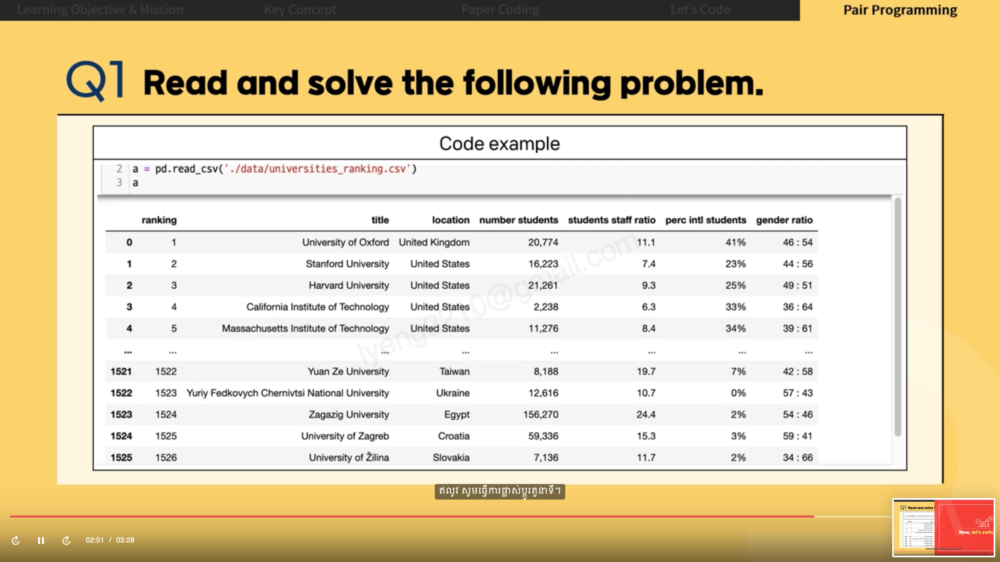

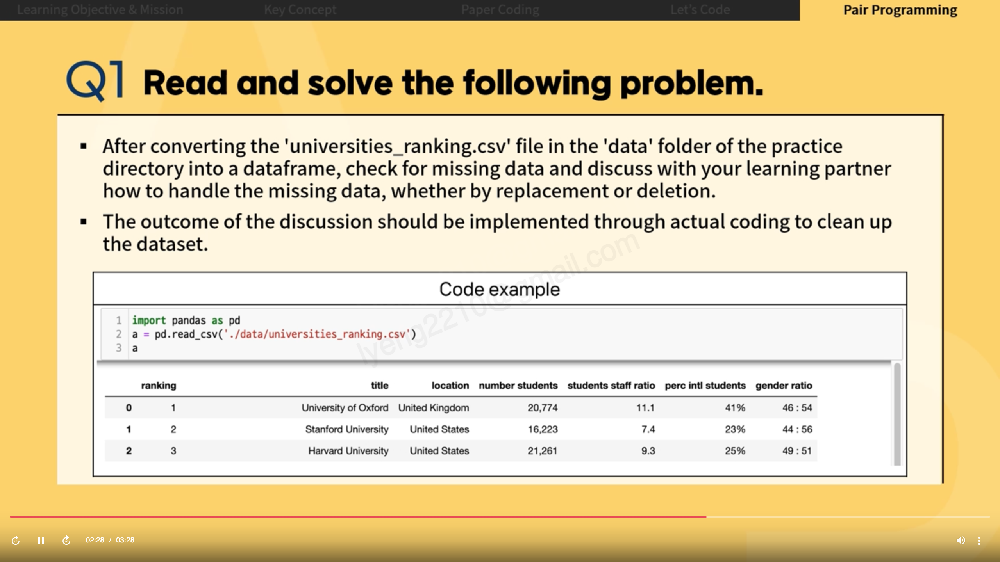